This notebook demonstrates various ways to combine Symbolic Regression methods with Neural differntial equations (NDEs) I explored during my internship at PIK. It only conveys the basic ideas behind the approaches and shows how to use the packages I wrote. For an analysis and comparison of the different methods see the notebook "analysis.ipynb".

In [10]:
using Revise
using Plots, OrdinaryDiffEq

push!(LOAD_PATH, "../src")

using Pendulum, SymReg

## Generate data

For this example we will look at a double pendulum system whith initial condition

$$\begin{pmatrix}\theta_1\\\theta_2\\\omega_1\\\omega_2\end{pmatrix} = \begin{pmatrix}\pi/2\\\pi/2\\0\\0\end{pmatrix}$$

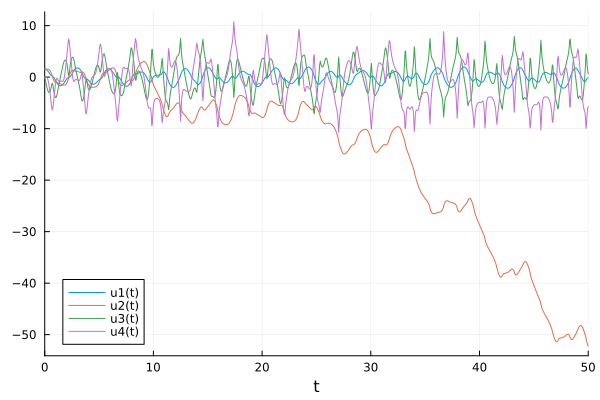

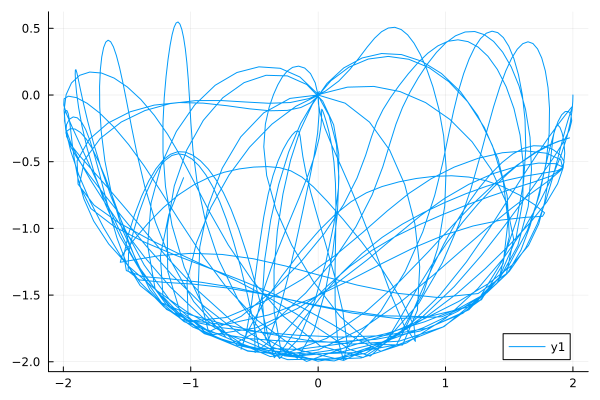

In [2]:
m1 = 1 #units of kg
m2 = 1 
l1 = 1 #units of m
l2 = 1
g = 10 #units of kg*m/s^2

pendulum = DoublePendulum([m1, m2, l1, l2, g])

x0 = [Float32(π/2), Float32(π/2), 0f0, 0f0] 

t_transient = 0f0
N_t = 1000
dt = 0.05f0

times = t_transient:dt:t_transient + N_t * dt

sol = trajectory(pendulum, x0, N_t, dt, t_transient)
display(plot(sol))
plot_trajectory(pendulum, sol)

[ Info: Saved animation to c:\Users\Simon\Documents\PIK\Code\SymbolicNODE.jl\test\pendulum.gif


Plots.AnimatedGif("c:\\Users\\Simon\\Documents\\PIK\\Code\\SymbolicNODE.jl\\test\\pendulum.gif")
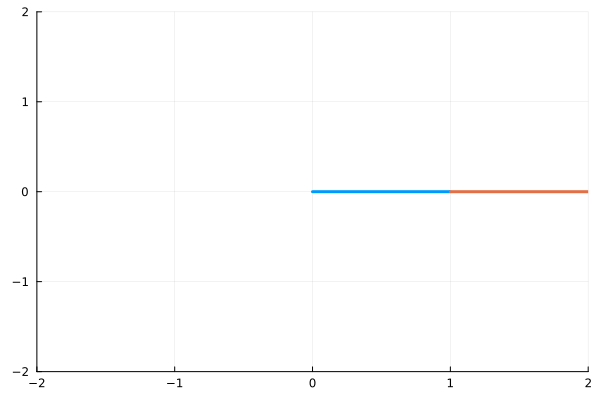

In [4]:
create_animation(pendulum, sol)

## Fitting SINDy model

We first fit a SINDy model to the data. The SINDy constructor automatically fits the model for a basis of polynomial, sin and cos functions. poly_base and trig_base specify the maximal order of the respective basis functions. The model can be evaluated at a given point in phase space $x$ by simply calling $\text{sindy}(x)$.

In [25]:
sindy = SINDy(sol; poly_base=2, trig_base=2)

SINDy{DataDrivenDiffEq.DataDrivenSolution{Float32}}("DataDrivenSolution{Float32}")

In [29]:
sindy.sol.basis

Model ##Basis#4302 with 4 equations
States (4):
  (x(t))[1]
  (x(t))[2]
  (x(t))[3]
  (x(t))[4]
Parameters (38):
  p₁
  p₂
  p₃
  p₄
  p₅
  p₆
⋮

### Results

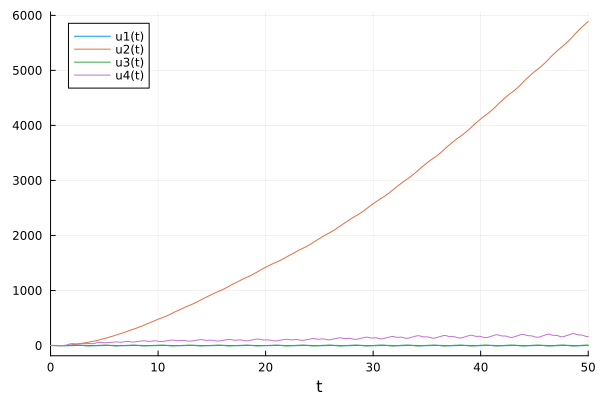

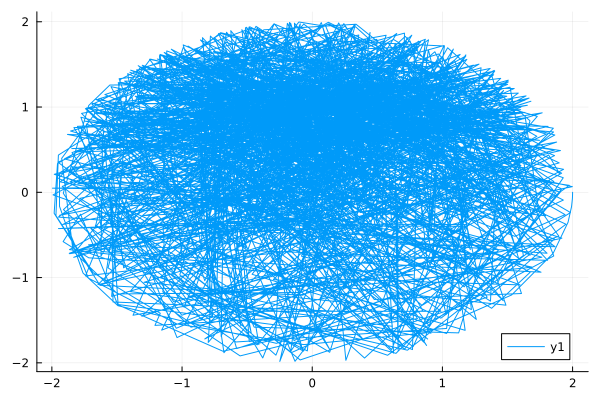

In [26]:
sindy_prob = ODEProblem(sindy,x0, (0f0, Float32(t_transient + N_t * dt)), sindy.sol.prob.p)
sindy_sol = solve(sindy_prob, Tsit5())
display(plot(sindy_sol))
plot_trajectory(pendulum, sindy_sol)

[ Info: Saved animation to c:\Users\Simon\Documents\PIK\Code\SymbolicNODE.jl\test\pendulum.gif


Plots.AnimatedGif("c:\\Users\\Simon\\Documents\\PIK\\Code\\SymbolicNODE.jl\\test\\pendulum.gif")
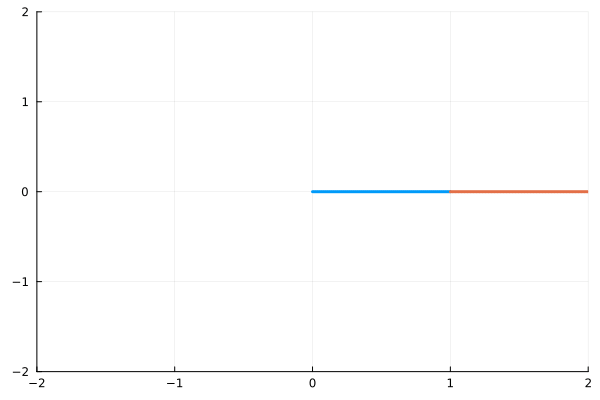

In [8]:
create_animation(pendulum, sindy_sol)

The reconstruction results are very bad, which can also be expected since the RHS of the double pendulum ODE is not in the function space spanned by the chosen basis. One could include further basis elements which are tailored to the specific form of the ODE. However this does not lead to a general method for arbitrary dynamical systems.

## Genetic Symbolic Regression

Instead we turn to an alternative Symbolic regression method implemented in SymbolicRegression.jl which uses genetic programming. Here we use a wrapper around the SymbolicRegression.jl methods in the form of the GeneticSymReg struct. It pretty much works like the SINDy struct before, in that the constructor fits the model using the specified parameters and the model can be evaluated with a simple call according to $\text{gsr}(x)$. The GeneticSymReg struct stores its reconstructed equations as Symbolic expressions from Symbolics.jl which dramatically increases computation speed especially in the backwards pass of the NDE training (see below).

In [18]:
gsr = GeneticSymReg(sol, collect(times); niter=60, maxsize=30, maxdepth=30)

GeneticSymReg{SymbolicRegression.CoreModule.OptionsStructModule.Options{Int64}, Vector{Any}, Vector{Any}, Vector{Any}}(Options(
    # Operators:
        binops=Function[+, *, /, -], unaops=Function[cos, sin],
    # Loss:
        loss=L2DistLoss,
    # Complexity Management:
        maxsize=30, maxdepth=30, bin_constraints=[(-1, -1), (-1, -1), (-1, -1), (-1, -1)], una_constraints=[-1, -1], use_frequency=true, use_frequency_in_tournament=true, parsimony=0.0032, warmup_maxsize_by=0.0, 
    # Search Size:
        npopulations=15, ncycles_per_iteration=550, npop=33, 
    # Migration:
        migration=true, hof_migration=true, fraction_replaced=0.00036, fraction_replaced_hof=0.035,
    # Tournaments:
        prob_pick_first=0.86, tournament_selection_n=12, topn=12, 
    # Constant tuning:
        perturbation_factor=0.076, probability_negate_constant=0.01, should_optimize_constants=true, optimizer_algorithm=BFGS, optimizer_probability=0.14, optimizer_nrestarts=2, optimizer_iterations=8,
   

In [83]:
for s in gsr.sol
    display(s)
end

x3 + -0.0009220541 / (sin(x1 / 0.3138269) - 0.0009220541 + x3*0.65508616)

x4 - 0.000115640985(((((sin(x2 - -0.9035712) / -0.13177429 - 0.34203613) - x2) / sin(-0.13177429 - x1) + x4)*0.7634899) - -0.34203613)

((((sin(x2 - x1)*(0.8676561 + cos(x1 - x2) / cos(x4*-0.13959633)))*cos(x1)) - sin(x1))*14.419945 + x1)*1.1344476

((((x3 + x3)*((x3 + sin(x3))*sin(x1 - x2)) + sin((x1 / 0.39484087) - x2)) / cos(-0.11056061x4)) - x1) - x1

### Results

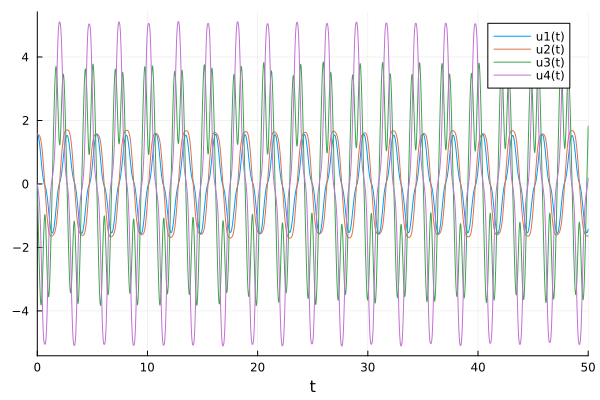

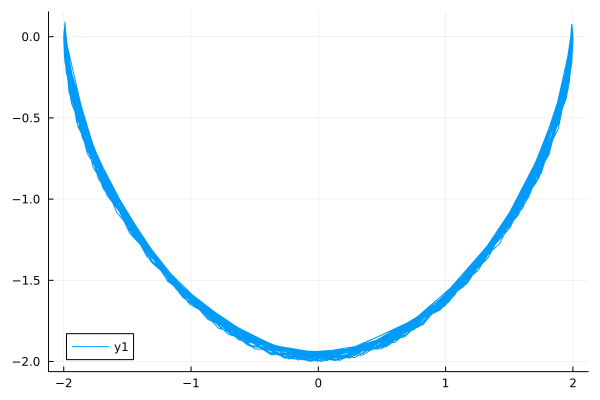

In [27]:
gsr_prob = ODEProblem((u,p,t) -> gsr(u),x0,(0f0, Float32(t_transient + N_t * dt)))
gsr_sol = solve(gsr_prob, Tsit5())
display(plot(gsr_sol))
plot_trajectory(pendulum, gsr_sol)

[ Info: Saved animation to c:\Users\Simon\Documents\PIK\Code\SymbolicNODE.jl\test\pendulum.gif


Plots.AnimatedGif("c:\\Users\\Simon\\Documents\\PIK\\Code\\SymbolicNODE.jl\\test\\pendulum.gif")
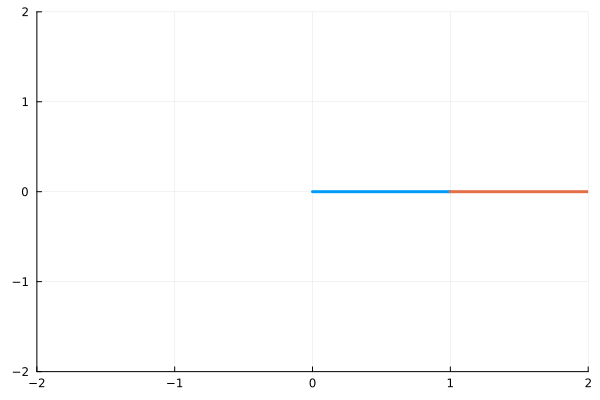

In [28]:
create_animation(pendulum, gsr_sol)

The results are already much better than for the SINDy fit. The model still lacks a lot of the true dynamics (especially the chaotic part). However the intuition is that the SymbolicRegression solution serves as a good "initial guess" which can be refined by a Neural ODE.

## Symbolic Augmentation

Giving the full solution of the SymbolicRegression as input to the Neural ODE, which would be the first naive approach of how to combine the two methods, can potentially lead to problems if the expressions are very big and complex. Intuitively it seems like a reasonable approach to split the expressions obtained by Symbolic Regression into smaller terms and pass the original features as well as the splitted terms as input to the Neural ODE. This is a kind of feature augmentation. This splitting is handled by the struct "SymbolicAugment". It requires a trained GeneticSymReg model and the indices of the expressions from which to extract the terms. As additional arguments one can pass the minimum and maximum sizes of the splitted terms. The size of an expression is equal to the number of performed operations, i.e. sin(x + y) would have size 2, exp(sin(x / y)) a size of 3 and so on. Once again the model can be evaluated by a simple call $\text{x\_aug}(x)$ which evaluates all splitted expressions at once and returns them as a vector.

In [66]:
x_aug = SymbolicAugment(gsr,[3,4];min_size=2, max_size=4)

SymbolicAugment{Vector{Any}, Int64, Vector{Any}, Vector{Any}}(Any[:(sin(x2 - x1)), :(cos(x1 - x2)), :(cos(x4 * -0.13959633f0)), :(x3 + sin(x3)), :(sin(x1 - x2)), :(x1 / 0.39484087f0 - x2), :(sin(x1 / 0.39484087f0 - x2)), :(cos(-0.11056061f0x4))], 8, Any[SymReg.var"#99#100"(), SymReg.var"#101#102"(), SymReg.var"#103#104"(), SymReg.var"#105#106"(), SymReg.var"#107#108"(), SymReg.var"#109#110"(), SymReg.var"#111#112"(), SymReg.var"#113#114"()], Any[[2, 1], [1, 2], [4], [3], [1, 2], [2, 1], [2, 1], [4]])

In [67]:
import Symbolics
for eqn in x_aug.split
    display(Symbolics.parse_expr_to_symbolic(eqn, Main))
end

sin(x2 - x1)

cos(x1 - x2)

cos(-0.13959633x4)

x3 + sin(x3)

sin(x1 - x2)

2.532666x1 - x2

sin(2.532666x1 - x2)

cos(-0.11056061x4)

## Neural ODE + SymbolicRegression

In [34]:
push!(LOAD_PATH, "../src")
using NeuralODE

[ Info: Precompiling NeuralODE [top-level]


In the following we look at different possibilities of how to combine SymbolicRegression methods with a Neural ODE and benchmark the computation time for a single forward and backward pass.

### Benchmarking forward and backward pass of different NODE + SymbolicRegression combinations

In [42]:
using BenchmarkTools
import SciMLSensitivity: BacksolveAdjoint, ReverseDiffVJP
import SciMLBase: FullSpecialize
import Flux

In [43]:
train_data = generate_train_data(pendulum, 2, x0; N_t=N_t, dt=dt, t_transient=t_transient)

loss = Flux.Losses.mse

mse (generic function with 1 method)

#### Plain Neural ODE

As a baseline we use a plain Neural ODE. For all models shown below we put in the trivial first two components of the ODE as prior knowledge. 

In [60]:
p, re_nn = NODE_ANN(4,2,4,2)

function node(du, u, p, t)
    θ₁, θ₂, ω₁, ω₂ = u

    du[1] = ω₁
    du[2] = ω₂
    du[3:4] .= re_nn(p)(u)

    return nothing
end

node_prob = ODEProblem{true, FullSpecialize}(node, x0, (Float32(0.),Float32(dt)), p)
model = NODE(node_prob, sensealg=BacksolveAdjoint(;autojacvec = ReverseDiffVJP(true),))

#Benchmark forward pass 
@btime model((Array(times)[1:2], train_data.data[:,1:2]))

#Benchmark backward pass
@btime g = Flux.withgradient(model) do m 
    result = m((Array(times)[1:2], train_data.data[:,1:2]))
    loss(result, train_data.data[:,1:2])
end

  429.600 μs (2585 allocations: 116.23 KiB)
  1.002 ms (4289 allocations: 284.70 KiB)


(val = 0.028010856f0, grad = ((p = Float32[0.007887564, 0.0, 0.0007274815, -0.004549746, 0.007885615, 0.0, 0.00072729227, -0.004548632, -8.288527f-5, 0.0  …  0.002618176, -0.00040905125, 0.0, 0.0, 0.006017945, -0.00094227924, 0.010472154, -0.0016390284, 0.005856827, -0.0009163567], prob = nothing, alg = nothing, kwargs = nothing),))

#### Neural ODE + SINDy

When combining Neural ODE and Symbolic Regression we always concatenate the output of the Symbolic Regression model with the original point in phase space to give the NeuralODE more modeling power. This also prevents the loss of information in the Symbolic Regression transformation.

In [59]:
p, re_nn = NODE_ANN(6,2,4,2)

function node(du, u, p, t)
    θ₁, θ₂, ω₁, ω₂ = u

    du[1] = ω₁
    du[2] = ω₂
    du[3:4] .= re_nn(p)(vcat(sindy(u)[3:4],u))

    return nothing
end

node_prob = ODEProblem{true, FullSpecialize}(node, x0, (Float32(0.),Float32(dt)), p)
model = NODE(node_prob, sensealg=BacksolveAdjoint(;autojacvec = ReverseDiffVJP(true),))

#Benchmark forward pass 
@btime model((Array(times)[1:2], train_data.data[:,1:2]))

#Benchmark backward pass
@btime g = Flux.withgradient(model) do m 
    result = m((Array(times)[1:2], train_data.data[:,1:2]))
    loss(result, train_data.data[:,1:2])
end


  599.400 μs (3569 allocations: 166.34 KiB)
  1.625 ms (7209 allocations: 413.69 KiB)


(val = 0.017466508f0, grad = ((p = Float32[0.0, 0.0, 0.010810381, 0.0, 0.0, 0.0, 0.018462015, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.02152948, -0.004602773, 0.0, 0.0, 0.0045610936, -0.00097508915], prob = nothing, alg = nothing, kwargs = nothing),))

#### Neural ODE + Genetic SymbolicRegression

In [61]:
p, re_nn = NODE_ANN(6,2,4,2)

function node(du, u, p, t)
    θ₁, θ₂, ω₁, ω₂ = u

    du[1] = ω₁
    du[2] = ω₂
    du[3:4] .= re_nn(p)(vcat(gsr(u)[3:4],u))

    return nothing
end

node_prob = ODEProblem{true, FullSpecialize}(node, x0, (Float32(0.),Float32(dt)), p)
model = NODE(node_prob, sensealg=BacksolveAdjoint(;autojacvec = ReverseDiffVJP(true),))

#Benchmark forward pass 
@btime model((Array(times)[1:2], train_data.data[:,1:2]))

#Benchmark backward pass
@btime g = Flux.withgradient(model) do m 
    result = m((Array(times)[1:2], train_data.data[:,1:2]))
    loss(result, train_data.data[:,1:2])
end


  1.009 ms (6288 allocations: 318.86 KiB)
  2.021 ms (9546 allocations: 553.11 KiB)


(val = 0.021082018f0, grad = ((p = Float32[-0.074654214, 0.0, -0.03484169, 0.0, -0.012579382, 0.0, -0.005870994, 0.0, 0.008015358, 0.0  …  -0.012482504, 0.03169704, 0.0, 0.0, -0.02071571, 0.0525845, 0.0, 0.0, -0.0018710307, 0.0047503575], prob = nothing, alg = nothing, kwargs = nothing),))

#### Neural ODE + Feature augmentation (extracted from SymbolicRegression)

In [84]:
p, re_nn = NODE_ANN(x_aug.N_eqn + 4,2,64,2,activation=tanh)

function node(du, u, p, t)
    θ₁, θ₂, ω₁, ω₂ = u

    du[1] = ω₁
    du[2] = ω₂
    du[3:4] .= re_nn(p)(vcat(x_aug(u),u))

    return nothing
end

node_prob = ODEProblem{true, FullSpecialize}(node, x0, (Float32(0.),Float32(dt)), p)
model = NODE(node_prob, sensealg=BacksolveAdjoint(;autojacvec = ReverseDiffVJP(true),))

#Benchmark forward pass 
@btime model((Array(times)[1:2], train_data.data[:,1:2]))

#Benchmark backward pass
@btime g = Flux.withgradient(model) do m 
    result = m((Array(times)[1:2], train_data.data[:,1:2]))
    loss(result, train_data.data[:,1:2])
end

  682.300 μs (4055 allocations: 364.95 KiB)
  2.447 ms (11334 allocations: 1.05 MiB)


(val = 0.027204478f0, grad = ((p = Float32[-1.3763791f-8, -5.72846f-8, -1.8164632f-8, -1.5920405f-8, 3.347862f-8, 3.790618f-8, 5.3193245f-9, 9.78374f-8, -1.2256996f-7, -8.369914f-8  …  -0.003379041, 0.0003911956, 0.004184151, -0.00048440762, -0.0025852462, 0.0002993027, -0.00072063575, 8.341903f-5, 0.0057326625, -0.0006636788], prob = nothing, alg = nothing, kwargs = nothing),))

# Train model

The following shows an exmaple of how to train one of the above models. This only shows the basic usage of the train_NODE function. For a full training of the models see "analysis.ipynb".

In [86]:
#using Flux
train_data, valid_data = generate_train_data(pendulum, 2, x0; N_t=N_t, dt=dt, t_transient=t_transient, valid_set=0.5)

p, re_nn = NODE_ANN(6,2,4,2)

function node(du, u, p, t)
    θ₁, θ₂, ω₁, ω₂ = u

    du[1] = ω₁
    du[2] = ω₂
    du[3:4] .= re_nn(p)(vcat(gsr(u)[3:4],u))

    return nothing
end

node_prob = ODEProblem{true, FullSpecialize}(node, x0, (Float32(0.),Float32(dt)), p)
model = NODE(node_prob, sensealg=BacksolveAdjoint(;autojacvec = ReverseDiffVJP(true),))

NODE{Vector{Float32}, ODEProblem{Vector{Float32}, Tuple{Float32, Float32}, true, Vector{Float32}, ODEFunction{true, FullSpecialize, typeof(node), LinearAlgebra.UniformScaling{Bool}, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, typeof(SciMLBase.DEFAULT_OBSERVED), Nothing, Nothing}, Base.Pairs{Symbol, Union{}, Tuple{}, NamedTuple{(), Tuple{}}}, SciMLBase.StandardODEProblem}, Tsit5{typeof(OrdinaryDiffEq.trivial_limiter!), typeof(OrdinaryDiffEq.trivial_limiter!), Static.False}, Base.Pairs{Symbol, BacksolveAdjoint{0, true, Val{:central}, ReverseDiffVJP{true}}, Tuple{Symbol}, NamedTuple{(:sensealg,), Tuple{BacksolveAdjoint{0, true, Val{:central}, ReverseDiffVJP{true}}}}}}(Float32[0.20732026, -0.5125974, 0.76959467, -0.47349507, -0.47440213, -0.20490292, -0.32689056, 0.21446232, 0.65904427, -0.14613497  …  -0.30999875, 0.13422716, -0.03340733, -0.6974387, -0.85677505, 0.339962, 0.8801056, -0.96730065, 0.0, 0.0], ODEProble

In [87]:
train_losses, valid_losses = train_NODE(model, train_data, 10; valid_data=valid_data, η=1f-3, decay=1f-6, print_every=1)

Begin training
Epoch: 1; Train Loss: 0.2738901; Validation Loss: 0

┌ Warning: dt(1.9073486e-6) <= dtmin(1.9073486e-6) at t=27.09267. Aborting. There is either an error in your model specification or the true solution is unstable.
└ @ SciMLBase C:\Users\Simon\.julia\packages\SciMLBase\o0qGB\src\integrator_interface.jl:532
┌ Warning: An error occured while calculating the validation loss
└ @ NeuralODE c:\Users\Simon\Documents\PIK\Code\SymbolicNODE.jl\src\NeuralODE.jl:127



Epoch: 2; Train Loss: 0.19165386; Validation Loss: 0.24543272
Epoch: 3; Train Loss: 0.15072682; Validation Loss: 0.19858661
Epoch: 4; Train Loss: 0.12308674; Validation Loss: 0.16827196
Epoch: 5; Train Loss: 0.10456109; Validation Loss: 0.15455857
Epoch: 6; Train Loss: 0.09411743; Validation Loss: 0.14541104
Epoch: 7; Train Loss: 0.0885302; Validation Loss: 0.13500781
Epoch: 8; Train Loss: 0.084443666; Validation Loss: 0.12523118
Epoch: 9; Train Loss: 0.07907868; Validation Loss: 0.11142366
Epoch: 10; Train Loss: 0.0676189; Validation Loss: 0.0808893


(Float32[0.2738901, 0.19165386, 0.15072682, 0.12308674, 0.10456109, 0.09411743, 0.0885302, 0.084443666, 0.07907868, 0.0676189], Float32[NaN, 0.24543272, 0.19858661, 0.16827196, 0.15455857, 0.14541104, 0.13500781, 0.12523118, 0.11142366, 0.0808893])

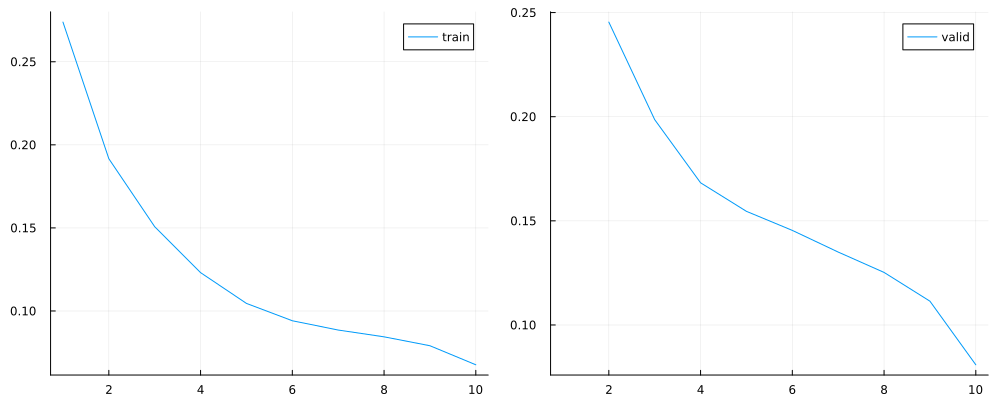

In [88]:
plot1 = plot(train_losses, label="train")
plot2 = plot(valid_losses, label="valid")
plot(plot1, plot2, layout = grid(1, 2), size=(1000,400))